<a href="https://colab.research.google.com/github/Meytalke/Deep-Vision-Final-Project/blob/main/DeepVisionFinalProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# imports
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import shutil
import time
import math
import io
import html
from statistics import mean
from base64 import b64decode, b64encode

# Google Colab
from google.colab import files, output
from google.colab.output import eval_js
from google.colab.patches import cv2_imshow

# IPython
from IPython.display import display, Javascript, Image, clear_output

# Pillow (PIL)
from PIL import Image

# PyTorch
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torchsummary import summary

# TorchVision
import torchvision
import torchvision.datasets as dset
from torchvision import datasets
import torchvision.transforms as transforms
from torchvision.transforms.functional import InterpolationMode
from torchvision.utils import save_image
import torchvision.utils as vutils

# Widgets
import ipywidgets as widgets

# Other
import random
import datetime
import imageio.v2 as imageio
import re
# from models.cycle_gan_model import CycleGANModel

In [ ]:
use_cuda = torch.cuda.is_available()
if use_cuda:
    print("Using CUDA")
    device = torch.device('cuda')
else:
    print("Using CPU")
    device = torch.device('cpu')

Using CUDA


In [ ]:
# !git clone https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix
# %cd pytorch-CycleGAN-and-pix2pix
# !pip install -r requirements.txt
# !pip install imageio

#Data set collection#

In [ ]:
# Place your code here (2): define your own video width and height
width = 224
height = 224

# functions for capturing webcam
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes


def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;

    var pendingResolve = null;
    var shutdown = false;

    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }

    function onAnimationFrame(width, height) {
      if (!shutdown) {
         window.requestAnimationFrame(function() {
            onAnimationFrame(width, height);
    });
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, width, height);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }

    async function createDom(width, height) {
      if (div !== null) {
        return stream;
      }

      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);

      const modelOut = document.createElement('div');
      modelOut.innerHTML = "Status:";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);

      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);

      const instruction = document.createElement('div');
      instruction.innerHTML =
          '' +
          'When finished, click here or on the video to stop this demo';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };

      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = width; //video.videoWidth;
      captureCanvas.height = height; //video.videoHeight;
      window.requestAnimationFrame(function() {
      onAnimationFrame(width, height);
    });
      return stream;
    }

 async function stop_sream() {
        shutdown = true;
        removeDom();

        return '';
 }

    async function stream_frame(label, imgData, width, height) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom(width, height);

      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }

      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }

      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;

      return {'create': preShow - preCreate,
              'show': preCapture - preShow,
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)

def video_frame(label, bbox, width, videoHeight):
  data = eval_js('stream_frame("{}", "{}", "{}", "{}")'.format(label, bbox, width, height))
  return data

def video_stream_stop():
  eval_js('stop_sream("{}")')


def grab_dataset(save_path):
    input('Press Enter to start capturing images for your face...')
    frame_num = 0
    saved_frames = 0
    video_stream()
    label_html = 'Capturing...'
    bbox = ''
    file_names = []
    frames = []

    while True:
        frame_num += 1
        js_reply = video_frame(label_html, bbox, width, height)
        if not js_reply:
            break

        frame = js_to_image(js_reply["img"])

        label_html = f'Saving...{saved_frames}'
        file_name = os.path.join(save_path, datetime.now().strftime("%m_%d_%Y_%H_%M_%S_") + f"{frame_num}.jpg")
        file_names.append(file_name)
        frames.append(frame)
        saved_frames += 1

        if saved_frames == num_of_images_to_save:
            video_stream_stop()
            print('Saving to disk...')
            for i, f in enumerate(file_names):
                cv2.imwrite(f, frames[i])
            break

In [ ]:
# # grab your dataset --> this should be an ongoing process, till you get good performance

# grab_dataset(dataset_dir + 'DomainA/train/')
# grab_dataset(dataset_dir + 'DomainA/test/')

In [ ]:
# # dataset upload (Now you have a dataset and need to upload it for training)
# # download dataset
# from google.colab import files

# files.upload()

In [ ]:
#extract your dataset zip file
# !unzip /content/dsFinalSketch.zip
from google.colab import drive
drive.mount('/content/drive')

!unzip /content/drive/MyDrive/dsFinalSketch.zip -d /content/
# !unzip /content/drive/MyDrive/saved_datasets/dataset.zip -d /content/

Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_25_79.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_26_80.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_26_81.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_26_82.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_27_83.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_27_84.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_27_85.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_28_86.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_28_87.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_28_88.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_29_89.jpg  
  inflating: /content/dataset/DomainA/train/0/04_06_2025_16_27_29_90.jpg  
  inflating: /content/dataset/DomainA/train/0/04_

#Dataset definition#

In [ ]:
# def resize_images(input_folder, output_folder, size=(224, 224)):
#     os.makedirs(output_folder, exist_ok=True)
#     for fname in os.listdir(input_folder):
#         if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
#             img = Image.open(os.path.join(input_folder, fname)).convert("RGB")
#             img = img.resize(size, Image.Resampling.LANCZOS)
#             img.save(os.path.join(output_folder, fname))
#     print(f"Resized images saved to: {output_folder}")

# resize_images('/content/dataset/DomainB/test/0', '/content/dataset/DomainB/test/0', size=(224, 224))
# resize_images('/content/dataset/DomainB/train/0', '/content/dataset/DomainB/train/0', size=(224, 224))

Resized images saved to: /content/‏‏dataset/DomainB/test/0
Resized images saved to: /content/‏‏dataset/DomainB/train/0


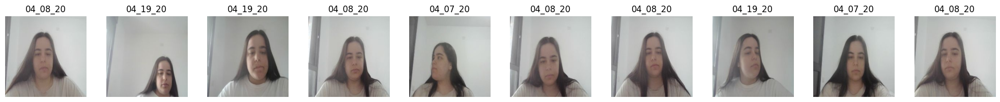

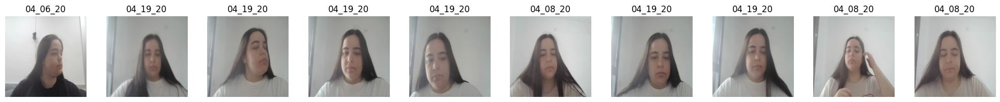

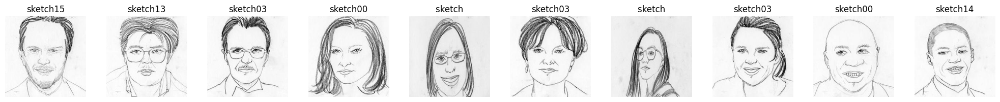

Training set size(DomainA): 2925
Test set size(DomainA): 975
Training set size(DomainB): 2104
Resolution: 224X224


In [ ]:
# Resizing images to a fixed size for uniformity and converting to tensors.
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])
# Loads Domain A training images
train_dataset = dset.ImageFolder(root='/content/dataset/DomainA/train', transform=transform)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=16, shuffle=True)
test_dataset = dset.ImageFolder(root='/content/dataset/DomainA/test', transform=transform)
test_loader = torch.utils.data.DataLoader(train_dataset, batch_size=16, shuffle=True)
# Loads Domain B training images
train_dataset_B = dset.ImageFolder(root='/content/dataset/DomainB/train', transform=transform)
train_loader_B = torch.utils.data.DataLoader(train_dataset_B, batch_size=16, shuffle=True)

# Displays n random images from a specific folder.
def show_samples_from_folder(folder_path, n=10):
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('jpg', 'jpeg', 'png'))]
    if not image_files:
        print(f"No image files found in {folder_path}")
        return

    random_image_files = random.sample(image_files, min(n, len(image_files)))

    fig, axs = plt.subplots(1, len(random_image_files), figsize=(len(random_image_files) * 2, 2))
    if len(random_image_files) == 1:
        axs = [axs]

    for i, filename in enumerate(random_image_files):
        img = Image.open(os.path.join(folder_path, filename)).convert("RGB")
        axs[i].imshow(img)
        axs[i].axis('off')
        axs[i].set_title(f"{filename[:8]}")
    plt.tight_layout()
    plt.show()

show_samples_from_folder('/content/dataset/DomainA/train/0')
show_samples_from_folder('/content/dataset/DomainA/test/0')
show_samples_from_folder('/content/dataset/DomainB/train/0')

print(f'Training set size(DomainA): {len(train_dataset)}')
print(f'Test set size(DomainA): {len(test_dataset)}')
print(f'Training set size(DomainB): {len(train_dataset_B)}')
print(f'Resolution: {width}X{height}')


In [ ]:
# !zip -r dataset.zip /content/dataset
# from google.colab import files
# files.download('dataset.zip')

In [ ]:
dataroot_A = '/content/dataset/DomainA/train/'
dataroot_test_A = '/content/dataset/DomainA/test/'
dataroot_B = '/content/dataset/DomainB/train/'
image_size = width
batch_size = 32

# Computes the per-channel mean and std for normalization
def compute_mean_std(dataset):
    loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)
    mean = 0.0
    std = 0.0
    n_samples = 0
    for images, _ in loader:
        n_samples += images.size(0)
        # Accumulate mean and std over the dataset
        mean += images.mean([0, 2, 3]) * images.size(0)
        std += images.std([0, 2, 3]) * images.size(0)
    mean /= n_samples
    std /= n_samples
    return mean, std

# Temporary transform to compute dataset mean and std (without normalization yet)
transform_temp = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor()
])

# Load datasets with temporary transform for mean/std calculation
dataset_A_temp = datasets.ImageFolder(root=dataroot_A, transform=transform_temp)
dataset_A_temp_test = datasets.ImageFolder(root=dataroot_test_A, transform=transform_temp)
dataset_B_temp = datasets.ImageFolder(root=dataroot_B, transform=transform_temp)

# Compute mean and std for each domain
mean_A, std_A = compute_mean_std(dataset_A_temp)
mean_A_test, std_A_test = compute_mean_std(dataset_A_temp_test)
mean_B, std_B = compute_mean_std(dataset_B_temp)

# Define transforms with normalization using computed mean and std
transform_A = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(mean_A, std_A)
])

transform_A_test = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(mean_A_test, std_A_test)
])

transform_B = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(mean_B, std_B)
])

# Apply the final transforms to the datasets
dataset_A = datasets.ImageFolder(root=dataroot_A, transform=transform_A)
dataset_test_A = datasets.ImageFolder(root=dataroot_test_A, transform=transform_A_test)
dataset_B = datasets.ImageFolder(root=dataroot_B, transform=transform_B)

# Ensure dataset A and B have the same length by truncating the longer one
min_len = min(len(dataset_A), len(dataset_B))
dataset_A = torch.utils.data.Subset(dataset_A, range(min_len))
dataset_B = torch.utils.data.Subset(dataset_B, range(min_len))

# Create dataloaders for training and testing
dataloader_A = data.DataLoader(dataset_A, batch_size=batch_size, shuffle=True)
dataloader_test_A = data.DataLoader(dataset_test_A, batch_size=batch_size, shuffle=True)
dataloader_B = data.DataLoader(dataset_B, batch_size=batch_size, shuffle=True)

#Training#

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Applies normal initialization (mean=0, std=0.02) - like DCGAN
def init_weights(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# Monitors loss to stop training early and avoid overfitting.
class EarlyStopping:
    def __init__(self, patience=10, delta=0.001):
        self.patience = patience
        self.delta = delta
        self.counter = 0
        self.best_score = None
        self.early_stop = False

    def __call__(self, val_loss, model=None):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0
    def reset_counter(self):
        self.counter = 0

In [ ]:
# A standard residual block with two convolutional layers - help the generator retain image features
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(channels, channels, 5, padding=2),
            nn.InstanceNorm2d(channels),
            nn.ReLU(),
            nn.Conv2d(channels, channels, 5, padding=2),
            nn.InstanceNorm2d(channels)
        )

    def forward(self, x):
        return x + self.block(x)

# Encoder -> residual block -> decoder structure.
# Uses InstanceNorm2d and Tanh for stable training and output in [-1, 1] range.
class Generator(nn.Module):
    def __init__(self, in_nc=3, out_nc=3, ngf=64):
        super().__init__()
        self.model = nn.Sequential(
            nn.Conv2d(in_nc, ngf, 7, padding=3),
            nn.InstanceNorm2d(ngf),
            nn.ReLU(),
            nn.Conv2d(ngf, ngf * 2, 5, stride=2, padding=2),
            nn.InstanceNorm2d(ngf * 2),
            nn.ReLU(),
            ResidualBlock(ngf * 2),
            nn.ConvTranspose2d(ngf * 2, ngf, 5, stride=2, padding=2, output_padding=1),
            nn.InstanceNorm2d(ngf),
            nn.ReLU(),
            nn.Conv2d(ngf, out_nc, 7, padding=3),
            nn.Tanh()
        )

    def forward(self, x):
        return self.model(x)

# Discriminator network for distinguishing real from generated images.
class Discriminator(nn.Module):
    def __init__(self, in_nc=3, ndf=64):
        super().__init__()
        self.model = nn.Sequential(
            nn.Conv2d(in_nc, ndf, 5, stride=2, padding=2),
            nn.LeakyReLU(0.2),
            nn.Conv2d(ndf, ndf * 2, 5, stride=2, padding=2),
            nn.InstanceNorm2d(ndf * 2),
            nn.LeakyReLU(0.2),
            nn.Conv2d(ndf * 2, 1, 5, padding=2)
        )

    def forward(self, x):
        return self.model(x)

# CycleGANModel: A model for training CycleGAN for unpaired image-to-image translation between two domains (A <-> B).
class CycleGANModel(nn.Module):
    def __init__(self, lr=0.0002, beta1=0.5, lambda_cycle=10, device='cpu', ngf=64, ndf=64):
        super().__init__()

        self.device = device
        self.lambda_cycle = lambda_cycle

        # Two generators: A->B and B->A
        self.G_AtoB = Generator(ngf=ngf).to(self.device)
        self.G_BtoA = Generator(in_nc=3, out_nc=3, ngf=ngf).to(self.device)

        # Two discriminators: for domain A and domain B
        self.D_A = Discriminator(in_nc=3, ndf=ndf).to(self.device)
        self.D_B = Discriminator(in_nc=3, ndf=ndf).to(self.device)

        # Apply custom weight initialization to all networks
        self.G_AtoB.apply(init_weights)
        self.G_BtoA.apply(init_weights)
        self.D_A.apply(init_weights)
        self.D_B.apply(init_weights)

        # Define Adam optimizers for each model component, using beta1 as recommended in the CycleGAN paper
        self.optimizer_G = optim.Adam(
            list(self.G_AtoB.parameters()) + list(self.G_BtoA.parameters()),
            lr=lr, betas=(beta1, 0.999)
        )
        self.optimizer_D_A = optim.Adam(self.D_A.parameters(), lr=lr, betas=(beta1, 0.999))
        self.optimizer_D_B = optim.Adam(self.D_B.parameters(), lr=lr, betas=(beta1, 0.999))

        # Use StepLR to decay the learning rate every 10 epochs
        self.scheduler_G = optim.lr_scheduler.StepLR(self.optimizer_G, step_size=10, gamma=0.5)
        self.scheduler_D_A = optim.lr_scheduler.StepLR(self.optimizer_D_A, step_size=10, gamma=0.5)
        self.scheduler_D_B = optim.lr_scheduler.StepLR(self.optimizer_D_B, step_size=10, gamma=0.5)

        # MSELoss - used for GAN loss (Least-Squares GAN formulation)
        # L1Loss - used for cycle-consistency loss: enforces that A->B->A and B->A->B reconstructions are similar to the originals
        self.criterion_GAN = nn.MSELoss()
        self.criterion_cycle = nn.L1Loss()

    # Receives a batch of real images from both domains (A and B) and stores them for training
    def set_input(self, real_A, real_B):
        self.real_A = real_A.to(self.device)
        self.real_B = real_B.to(self.device)

    # Generates fake and reconstructed images:
    # real_A -> fake_B -> reconstructed_A
    # real_B -> fake_A -> reconstructed_B
    def forward(self):
        self.fake_B = self.G_AtoB(self.real_A)
        self.reconstructed_A = self.G_BtoA(self.fake_B)
        self.fake_A = self.G_BtoA(self.real_B)
        self.reconstructed_B = self.G_AtoB(self.fake_A)

    def backward_D_basic(self, netD, real, fake):
        """Calculate GAN loss for the discriminator"""
        D_real = netD(real)
        loss_real = self.criterion_GAN(D_real, torch.ones_like(D_real) * 0.9)
        D_fake = netD(fake.detach())
        loss_fake = self.criterion_GAN(D_fake, torch.zeros_like(D_fake) + 0.1)
        loss_D = (loss_real + loss_fake) * 0.5
        loss_D.backward()
        return loss_D

    def backward_D_A(self):
        """Calculate discriminator loss for domain A"""
        fake_A = self.fake_A
        self.loss_D_A = self.backward_D_basic(self.D_A, self.real_A, fake_A)

    def backward_D_B(self):
        """Calculate discriminator loss for domain B"""
        fake_B = self.fake_B
        self.loss_D_B = self.backward_D_basic(self.D_B, self.real_B, fake_B)

    def backward_G(self):
        """Calculate generator loss"""
        # GAN loss for both directions (A→B and B→A)
        self.loss_G_AtoB = self.criterion_GAN(self.D_B(self.fake_B), torch.ones_like(self.D_B(self.fake_B)))
        self.loss_G_BtoA = self.criterion_GAN(self.D_A(self.fake_A), torch.ones_like(self.D_A(self.fake_A)))
        # Cycle-consistency loss (scaled by lambda_cycle)
        self.loss_cycle_A = self.criterion_cycle(self.reconstructed_A, self.real_A) * self.lambda_cycle
        self.loss_cycle_B = self.criterion_cycle(self.reconstructed_B, self.real_B) * self.lambda_cycle
        # Total loss is the sum of all and backpropagated
        self.loss_G = self.loss_G_AtoB + self.loss_G_BtoA + self.loss_cycle_A + self.loss_cycle_B
        self.loss_G.backward()
        return self.loss_G
    # Executes one training step
    def optimize_parameters(self):
        # Runs forward
        self.forward()

        # Updates each discriminator
        self.optimizer_D_A.zero_grad()
        self.backward_D_A()
        self.optimizer_D_A.step()

        self.optimizer_D_B.zero_grad()
        self.backward_D_B()
        self.optimizer_D_B.step()

        # Updates the generators
        self.optimizer_G.zero_grad()
        self.backward_G()
        self.optimizer_G.step()

    # Returns current loss values for visualization
    def get_current_losses(self):
        return {
            'G_AtoB': self.loss_G_AtoB.item(),
            'G_BtoA': self.loss_G_BtoA.item(),
            'D_A': self.loss_D_A.item(),
            'D_B': self.loss_D_B.item(),
            'cycle_A': self.loss_cycle_A.item(),
            'cycle_B': self.loss_cycle_B.item()
        }

    # Returns real, fake, and reconstructed images for both domains for display
    def get_current_visuals(self):
        return self.real_A.detach().cpu(), self.fake_B.detach().cpu(), self.reconstructed_A.detach().cpu(), \
               self.real_B.detach().cpu(), self.fake_A.detach().cpu(), self.reconstructed_B.detach().cpu()

In [ ]:
# dataroot_A = '/content/dataset/DomainA/train/'
# dataroot_B = '/content/dataset/DomainB/train/'
# image_size = width
# batch_size = 32
# lr = 0.0002
# beta1 = 0.5
# num_epochs = 75
# ngf = 64
# ndf = 64
# lambda_cycle = 10

# dataroot_A = '/content/dataset/DomainA/train/'
# dataroot_B = '/content/dataset/DomainB/train/'
# image_size = width
# batch_size = 32
# lr = 0.0002
# beta1 = 0.5
# num_epochs = 200
# ngf = 64
# ndf = 64
# lambda_cycle = 5

image_size = width
batch_size = 32
lr = 0.0002
beta1 = 0.5
num_epochs = 200
ngf = 64
ndf = 64
lambda_cycle = 10

In [ ]:
model = CycleGANModel(lr=lr, beta1=beta1, lambda_cycle=lambda_cycle, device=device, ngf=ngf, ndf=ndf)

input_shape = (3, image_size, image_size)

print("Summary of Generator G_AtoB:")
summary(model.G_AtoB, input_size=input_shape)

print("\nSummary of Generator G_BtoA:")
summary(model.G_BtoA, input_size=input_shape)

print("\nSummary of Discriminator D_A:")
summary(model.D_A, input_size=input_shape)

print("\nSummary of Discriminator D_B:")
summary(model.D_B, input_size=input_shape)

Summary of Generator G_AtoB:
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           9,472
    InstanceNorm2d-2         [-1, 64, 224, 224]               0
              ReLU-3         [-1, 64, 224, 224]               0
            Conv2d-4        [-1, 128, 112, 112]         204,928
    InstanceNorm2d-5        [-1, 128, 112, 112]               0
              ReLU-6        [-1, 128, 112, 112]               0
            Conv2d-7        [-1, 128, 112, 112]         409,728
    InstanceNorm2d-8        [-1, 128, 112, 112]               0
              ReLU-9        [-1, 128, 112, 112]               0
           Conv2d-10        [-1, 128, 112, 112]         409,728
   InstanceNorm2d-11        [-1, 128, 112, 112]               0
    ResidualBlock-12        [-1, 128, 112, 112]               0
  ConvTranspose2d-13         [-1, 64, 224, 224]         204,864
   Instanc

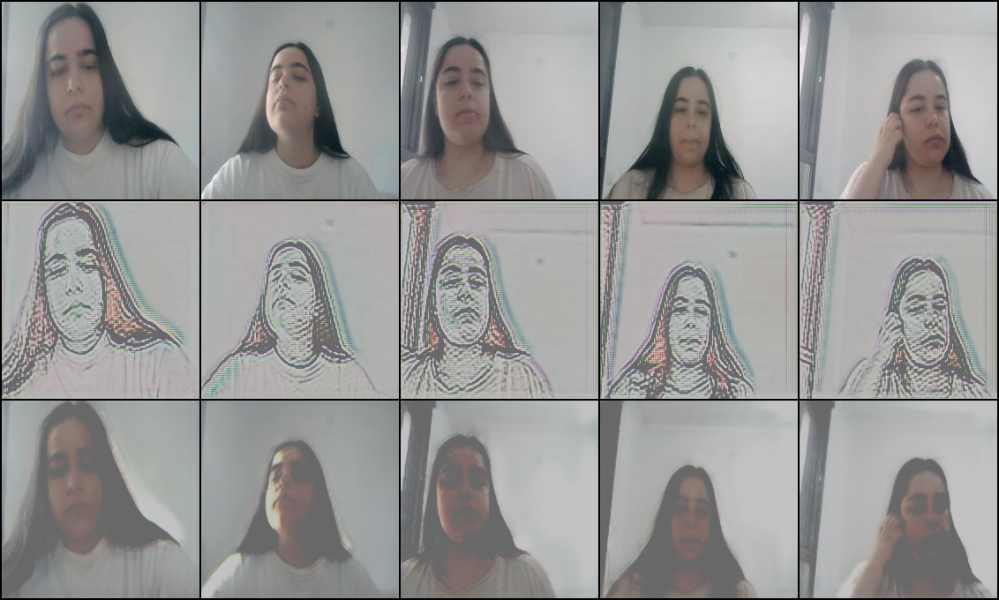

Saved progress images at epoch 1
Epoch [1/200] Loss_G: 1.2999, Loss_D_A: 0.0378, Loss_D_B: 0.0682, Loss_cycle_A: 2.9402, Loss_cycle_B: 3.0966
Saved best generator models with cycle loss: 6.0368
Epoch [2/200] Loss_G: 1.2452, Loss_D_A: 0.0774, Loss_D_B: 0.0623, Loss_cycle_A: 2.9575, Loss_cycle_B: 3.0192
Saved best generator models with cycle loss: 5.9767
Epoch [3/200] Loss_G: 1.3543, Loss_D_A: 0.0322, Loss_D_B: 0.0572, Loss_cycle_A: 2.8958, Loss_cycle_B: 3.0058
Saved best generator models with cycle loss: 5.9016
Epoch [4/200] Loss_G: 1.3606, Loss_D_A: 0.0243, Loss_D_B: 0.0461, Loss_cycle_A: 2.7380, Loss_cycle_B: 2.8617
Saved best generator models with cycle loss: 5.5997


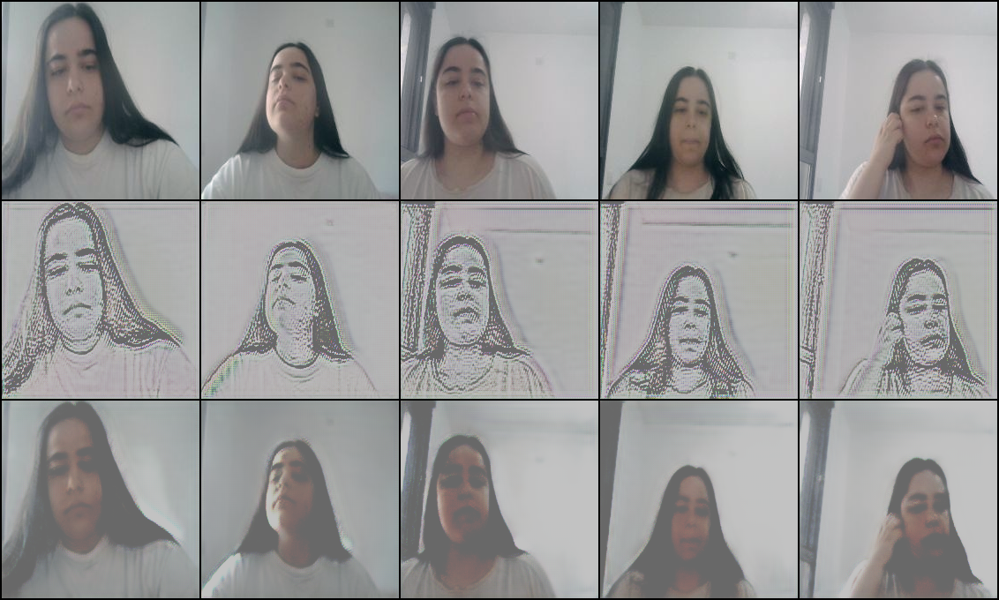

Saved progress images at epoch 5
Epoch [5/200] Loss_G: 1.3873, Loss_D_A: 0.0233, Loss_D_B: 0.0429, Loss_cycle_A: 2.7371, Loss_cycle_B: 2.8532
Saved best generator models with cycle loss: 5.5903
Epoch [6/200] Loss_G: 1.4106, Loss_D_A: 0.0222, Loss_D_B: 0.0407, Loss_cycle_A: 2.7383, Loss_cycle_B: 2.8452
Saved best generator models with cycle loss: 5.5835
Epoch [7/200] Loss_G: 1.4306, Loss_D_A: 0.0211, Loss_D_B: 0.0394, Loss_cycle_A: 2.7275, Loss_cycle_B: 2.8415
Saved best generator models with cycle loss: 5.5690
Epoch [8/200] Loss_G: 1.4437, Loss_D_A: 0.0204, Loss_D_B: 0.0377, Loss_cycle_A: 2.7165, Loss_cycle_B: 2.8079
Saved best generator models with cycle loss: 5.5244
Epoch [9/200] Loss_G: 1.4576, Loss_D_A: 0.0201, Loss_D_B: 0.0362, Loss_cycle_A: 2.7254, Loss_cycle_B: 2.8018
EarlyStopping counter: 1 out of 10


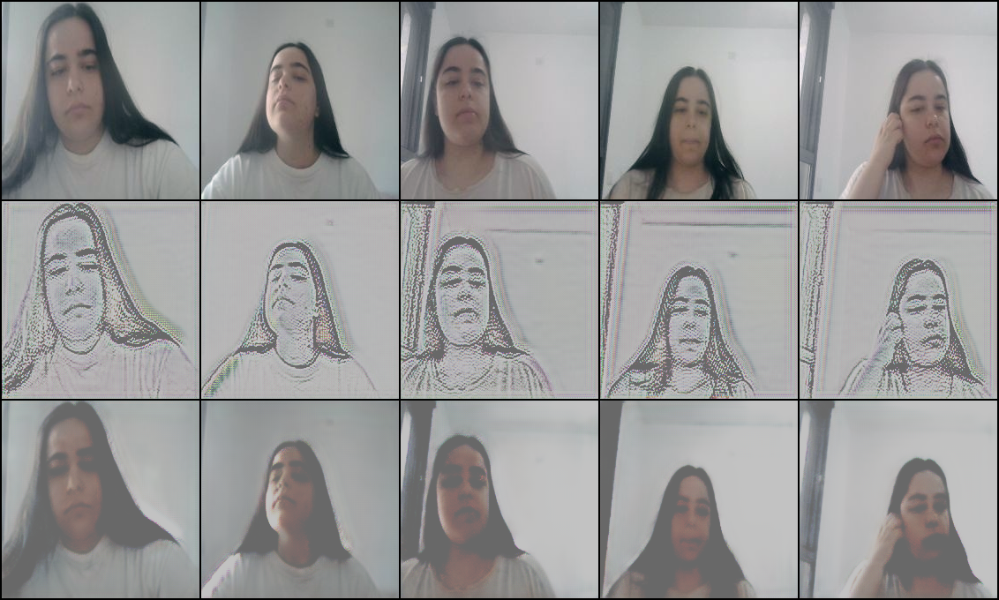

Saved progress images at epoch 10
Epoch [10/200] Loss_G: 1.4605, Loss_D_A: 0.0197, Loss_D_B: 0.0364, Loss_cycle_A: 2.7258, Loss_cycle_B: 2.8005
EarlyStopping counter: 2 out of 10
Epoch [11/200] Loss_G: 1.4626, Loss_D_A: 0.0188, Loss_D_B: 0.0398, Loss_cycle_A: 2.7100, Loss_cycle_B: 2.7922
Saved best generator models with cycle loss: 5.5022
Epoch [12/200] Loss_G: 1.4819, Loss_D_A: 0.0190, Loss_D_B: 0.0321, Loss_cycle_A: 2.7111, Loss_cycle_B: 2.7758
Saved best generator models with cycle loss: 5.4870
Epoch [13/200] Loss_G: 1.4892, Loss_D_A: 0.0181, Loss_D_B: 0.0314, Loss_cycle_A: 2.7020, Loss_cycle_B: 2.7449
Saved best generator models with cycle loss: 5.4469
Epoch [14/200] Loss_G: 1.4864, Loss_D_A: 0.0153, Loss_D_B: 0.0277, Loss_cycle_A: 2.6096, Loss_cycle_B: 2.6946
Saved best generator models with cycle loss: 5.3041


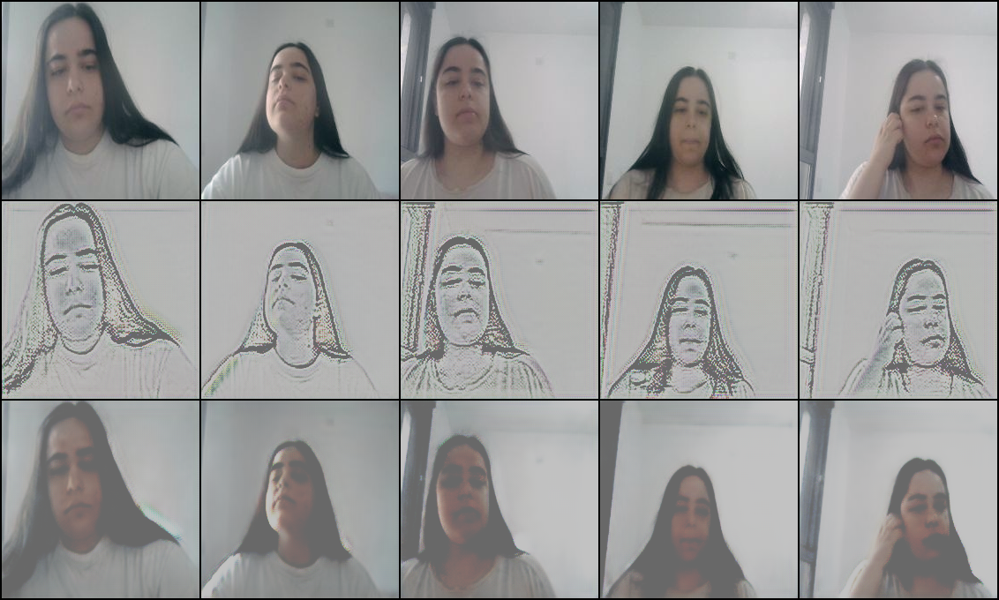

Saved progress images at epoch 15
Epoch [15/200] Loss_G: 1.4939, Loss_D_A: 0.0149, Loss_D_B: 0.0269, Loss_cycle_A: 2.6067, Loss_cycle_B: 2.6960
Saved best generator models with cycle loss: 5.3027
Epoch [16/200] Loss_G: 1.4989, Loss_D_A: 0.0148, Loss_D_B: 0.0261, Loss_cycle_A: 2.6083, Loss_cycle_B: 2.6879
Saved best generator models with cycle loss: 5.2962
Epoch [17/200] Loss_G: 1.5013, Loss_D_A: 0.0145, Loss_D_B: 0.0255, Loss_cycle_A: 2.6033, Loss_cycle_B: 2.6837
Saved best generator models with cycle loss: 5.2870
Epoch [18/200] Loss_G: 1.5032, Loss_D_A: 0.0141, Loss_D_B: 0.0251, Loss_cycle_A: 2.6033, Loss_cycle_B: 2.6811
Saved best generator models with cycle loss: 5.2844
Epoch [19/200] Loss_G: 1.5074, Loss_D_A: 0.0138, Loss_D_B: 0.0245, Loss_cycle_A: 2.6087, Loss_cycle_B: 2.6806
EarlyStopping counter: 1 out of 10


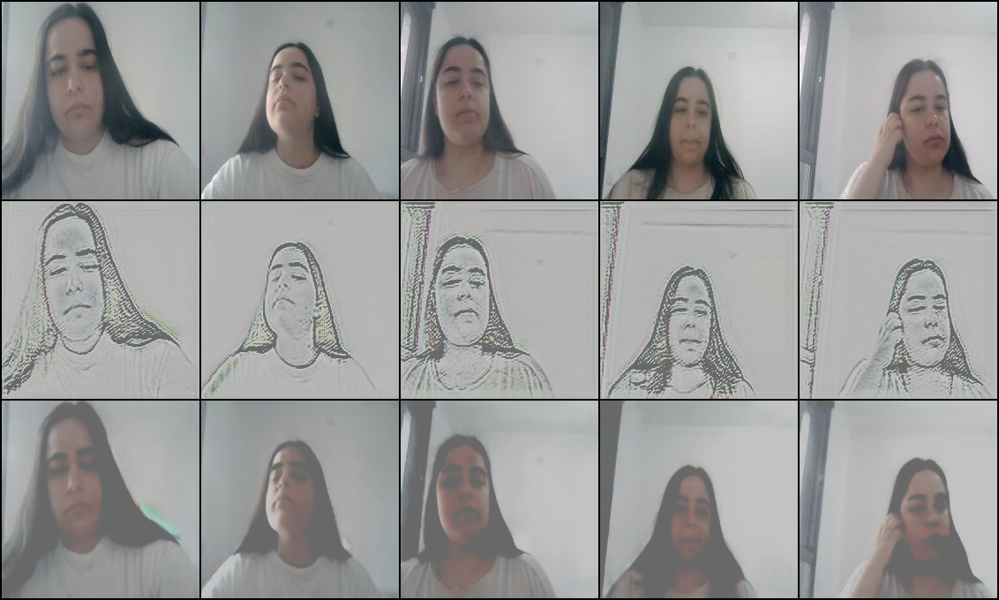

Saved progress images at epoch 20
Epoch [20/200] Loss_G: 1.5104, Loss_D_A: 0.0136, Loss_D_B: 0.0241, Loss_cycle_A: 2.6078, Loss_cycle_B: 2.6732
Saved best generator models with cycle loss: 5.2810
Epoch [21/200] Loss_G: 1.5135, Loss_D_A: 0.0133, Loss_D_B: 0.0237, Loss_cycle_A: 2.6048, Loss_cycle_B: 2.6798
EarlyStopping counter: 1 out of 10
Epoch [22/200] Loss_G: 1.5190, Loss_D_A: 0.0132, Loss_D_B: 0.0231, Loss_cycle_A: 2.6014, Loss_cycle_B: 2.6602
Saved best generator models with cycle loss: 5.2616
Epoch [23/200] Loss_G: 1.5226, Loss_D_A: 0.0131, Loss_D_B: 0.0225, Loss_cycle_A: 2.5960, Loss_cycle_B: 2.6592
Saved best generator models with cycle loss: 5.2552
Epoch [24/200] Loss_G: 1.5220, Loss_D_A: 0.0121, Loss_D_B: 0.0215, Loss_cycle_A: 2.5582, Loss_cycle_B: 2.6402
Saved best generator models with cycle loss: 5.1985


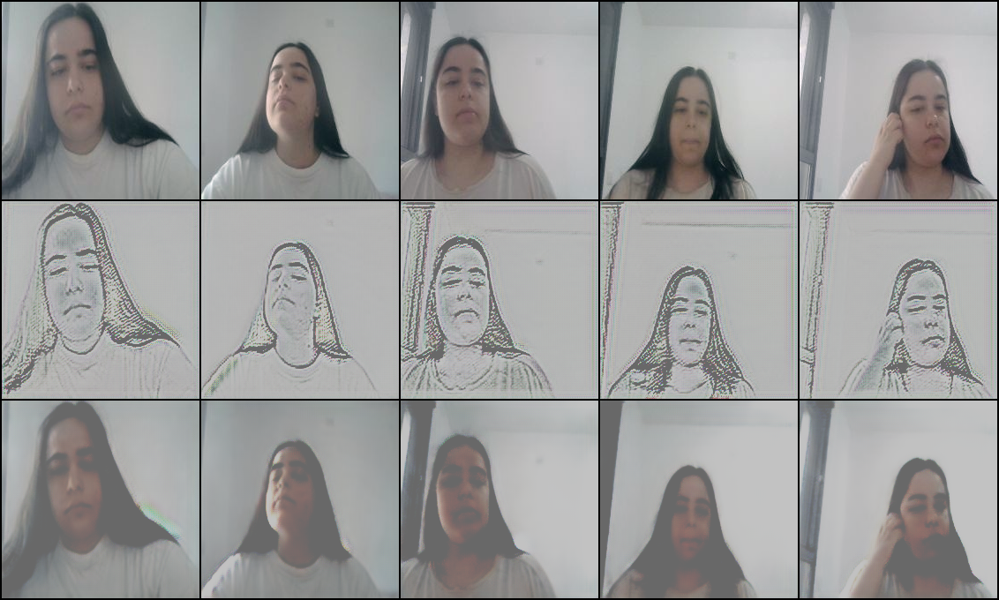

Saved progress images at epoch 25
Epoch [25/200] Loss_G: 1.5244, Loss_D_A: 0.0120, Loss_D_B: 0.0213, Loss_cycle_A: 2.5551, Loss_cycle_B: 2.6364
Saved best generator models with cycle loss: 5.1915
Epoch [26/200] Loss_G: 1.5276, Loss_D_A: 0.0118, Loss_D_B: 0.0209, Loss_cycle_A: 2.5552, Loss_cycle_B: 2.6344
Saved best generator models with cycle loss: 5.1896
Epoch [27/200] Loss_G: 1.5286, Loss_D_A: 0.0117, Loss_D_B: 0.0205, Loss_cycle_A: 2.5522, Loss_cycle_B: 2.6375
EarlyStopping counter: 1 out of 10
Epoch [28/200] Loss_G: 1.5303, Loss_D_A: 0.0116, Loss_D_B: 0.0202, Loss_cycle_A: 2.5515, Loss_cycle_B: 2.6316
Saved best generator models with cycle loss: 5.1831
Epoch [29/200] Loss_G: 1.5330, Loss_D_A: 0.0115, Loss_D_B: 0.0198, Loss_cycle_A: 2.5547, Loss_cycle_B: 2.6315
EarlyStopping counter: 1 out of 10


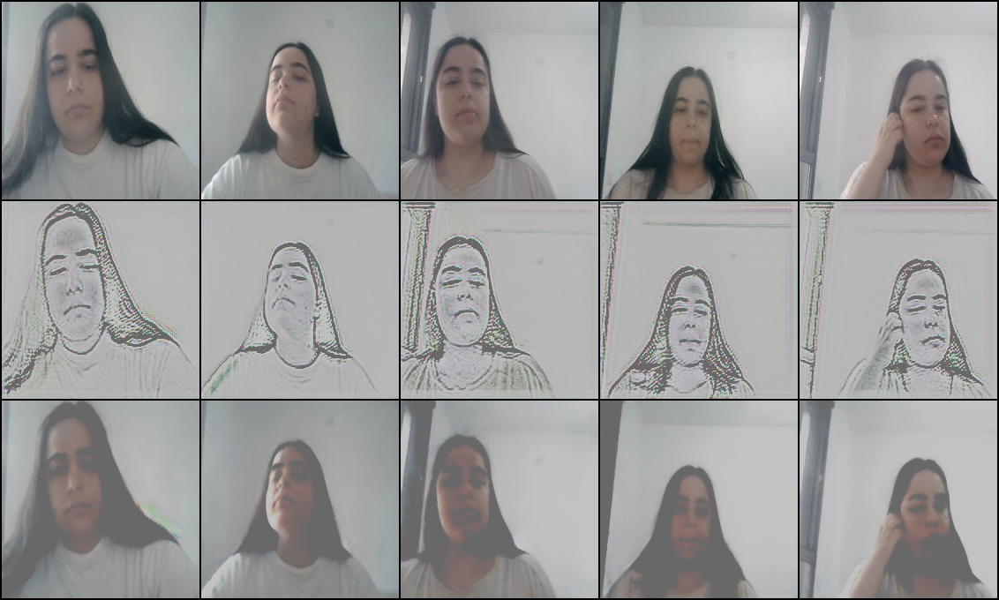

Saved progress images at epoch 30
Epoch [30/200] Loss_G: 1.5342, Loss_D_A: 0.0113, Loss_D_B: 0.0195, Loss_cycle_A: 2.5487, Loss_cycle_B: 2.6276
Saved best generator models with cycle loss: 5.1764
Epoch [31/200] Loss_G: 1.5364, Loss_D_A: 0.0112, Loss_D_B: 0.0192, Loss_cycle_A: 2.5478, Loss_cycle_B: 2.6280
Saved best generator models with cycle loss: 5.1758
EarlyStopping counter: 1 out of 10
Epoch [32/200] Loss_G: 1.5389, Loss_D_A: 0.0111, Loss_D_B: 0.0189, Loss_cycle_A: 2.5502, Loss_cycle_B: 2.6308
EarlyStopping counter: 2 out of 10
Epoch [33/200] Loss_G: 1.5395, Loss_D_A: 0.0110, Loss_D_B: 0.0187, Loss_cycle_A: 2.5465, Loss_cycle_B: 2.6246
Saved best generator models with cycle loss: 5.1711
Epoch [34/200] Loss_G: 1.5381, Loss_D_A: 0.0107, Loss_D_B: 0.0185, Loss_cycle_A: 2.5335, Loss_cycle_B: 2.6164
Saved best generator models with cycle loss: 5.1499


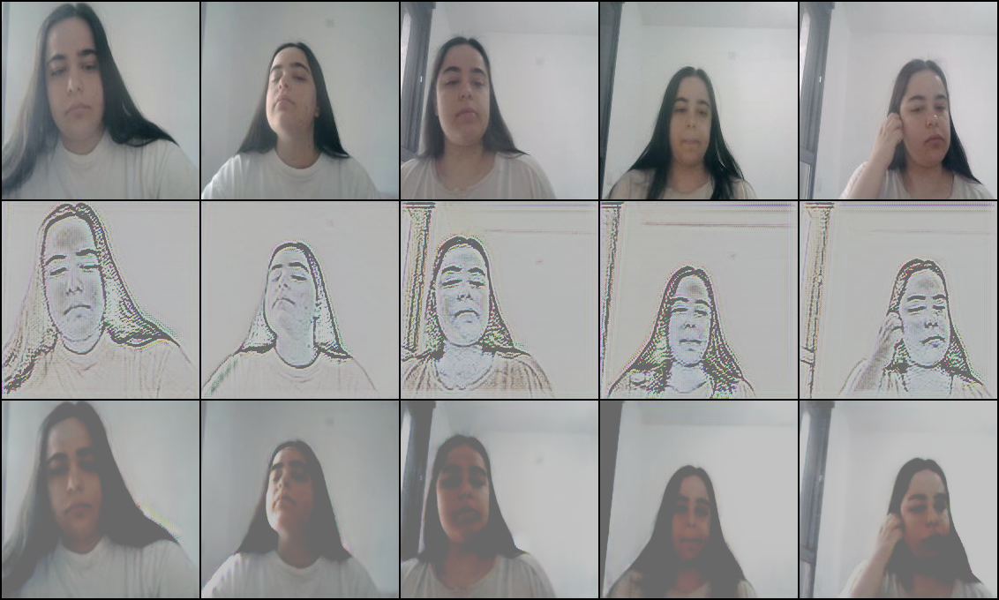

Saved progress images at epoch 35
Epoch [35/200] Loss_G: 1.5383, Loss_D_A: 0.0106, Loss_D_B: 0.0182, Loss_cycle_A: 2.5322, Loss_cycle_B: 2.6148
Saved best generator models with cycle loss: 5.1470
Epoch [36/200] Loss_G: 1.5411, Loss_D_A: 0.0105, Loss_D_B: 0.0181, Loss_cycle_A: 2.5329, Loss_cycle_B: 2.6133
Saved best generator models with cycle loss: 5.1462
EarlyStopping counter: 1 out of 10
Epoch [37/200] Loss_G: 1.5418, Loss_D_A: 0.0105, Loss_D_B: 0.0179, Loss_cycle_A: 2.5300, Loss_cycle_B: 2.6135
Saved best generator models with cycle loss: 5.1435
Epoch [38/200] Loss_G: 1.5430, Loss_D_A: 0.0104, Loss_D_B: 0.0178, Loss_cycle_A: 2.5315, Loss_cycle_B: 2.6106
Saved best generator models with cycle loss: 5.1421
Epoch [39/200] Loss_G: 1.5442, Loss_D_A: 0.0103, Loss_D_B: 0.0176, Loss_cycle_A: 2.5307, Loss_cycle_B: 2.6086
Saved best generator models with cycle loss: 5.1393


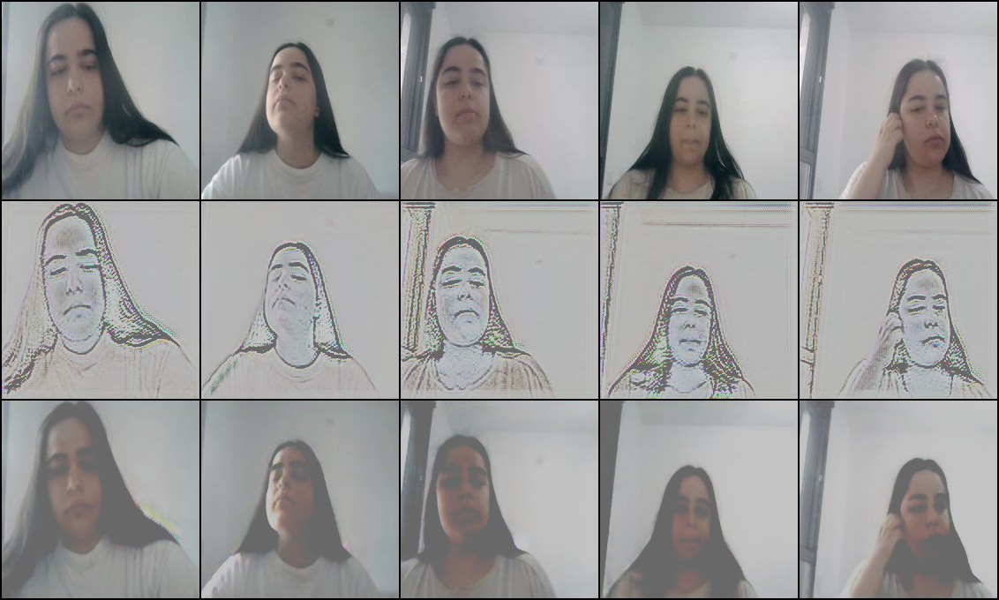

Saved progress images at epoch 40
Epoch [40/200] Loss_G: 1.5456, Loss_D_A: 0.0102, Loss_D_B: 0.0175, Loss_cycle_A: 2.5316, Loss_cycle_B: 2.6091
EarlyStopping counter: 1 out of 10
Epoch [41/200] Loss_G: 1.5459, Loss_D_A: 0.0102, Loss_D_B: 0.0173, Loss_cycle_A: 2.5289, Loss_cycle_B: 2.6073
Saved best generator models with cycle loss: 5.1362
Epoch [42/200] Loss_G: 1.5468, Loss_D_A: 0.0102, Loss_D_B: 0.0172, Loss_cycle_A: 2.5313, Loss_cycle_B: 2.6089
EarlyStopping counter: 1 out of 10
Epoch [43/200] Loss_G: 1.5471, Loss_D_A: 0.0101, Loss_D_B: 0.0170, Loss_cycle_A: 2.5285, Loss_cycle_B: 2.6036
Saved best generator models with cycle loss: 5.1321
Epoch [44/200] Loss_G: 1.5474, Loss_D_A: 0.0100, Loss_D_B: 0.0169, Loss_cycle_A: 2.5243, Loss_cycle_B: 2.6039
Saved best generator models with cycle loss: 5.1282


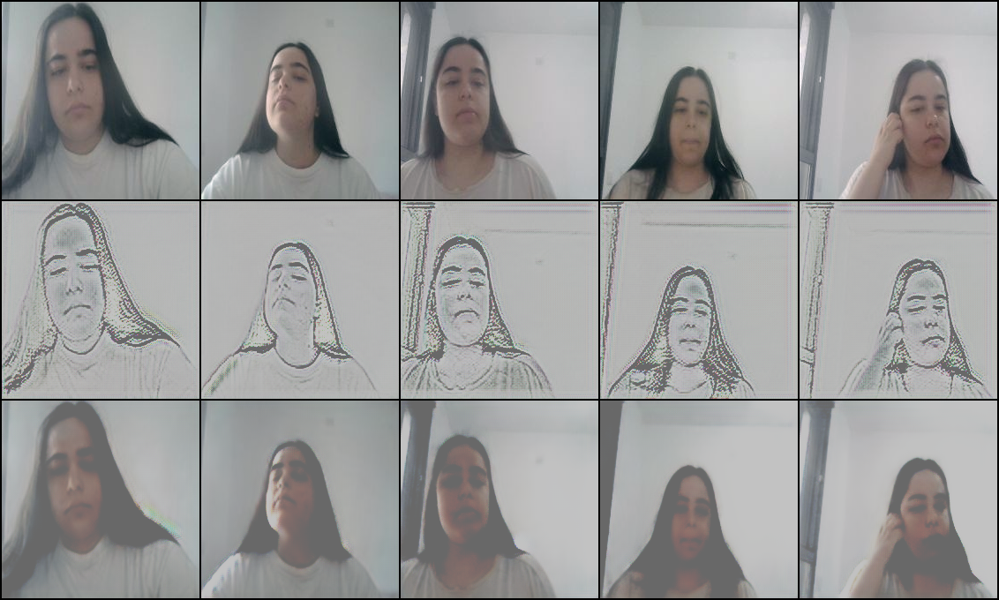

Saved progress images at epoch 45
Epoch [45/200] Loss_G: 1.5479, Loss_D_A: 0.0100, Loss_D_B: 0.0168, Loss_cycle_A: 2.5246, Loss_cycle_B: 2.6018
Saved best generator models with cycle loss: 5.1264
Epoch [46/200] Loss_G: 1.5484, Loss_D_A: 0.0099, Loss_D_B: 0.0168, Loss_cycle_A: 2.5209, Loss_cycle_B: 2.6025
Saved best generator models with cycle loss: 5.1233
Epoch [47/200] Loss_G: 1.5487, Loss_D_A: 0.0099, Loss_D_B: 0.0166, Loss_cycle_A: 2.5214, Loss_cycle_B: 2.6007
Saved best generator models with cycle loss: 5.1222
Epoch [48/200] Loss_G: 1.5503, Loss_D_A: 0.0098, Loss_D_B: 0.0165, Loss_cycle_A: 2.5202, Loss_cycle_B: 2.6009
Saved best generator models with cycle loss: 5.1211
Epoch [49/200] Loss_G: 1.5519, Loss_D_A: 0.0097, Loss_D_B: 0.0165, Loss_cycle_A: 2.5209, Loss_cycle_B: 2.5966
Saved best generator models with cycle loss: 5.1175


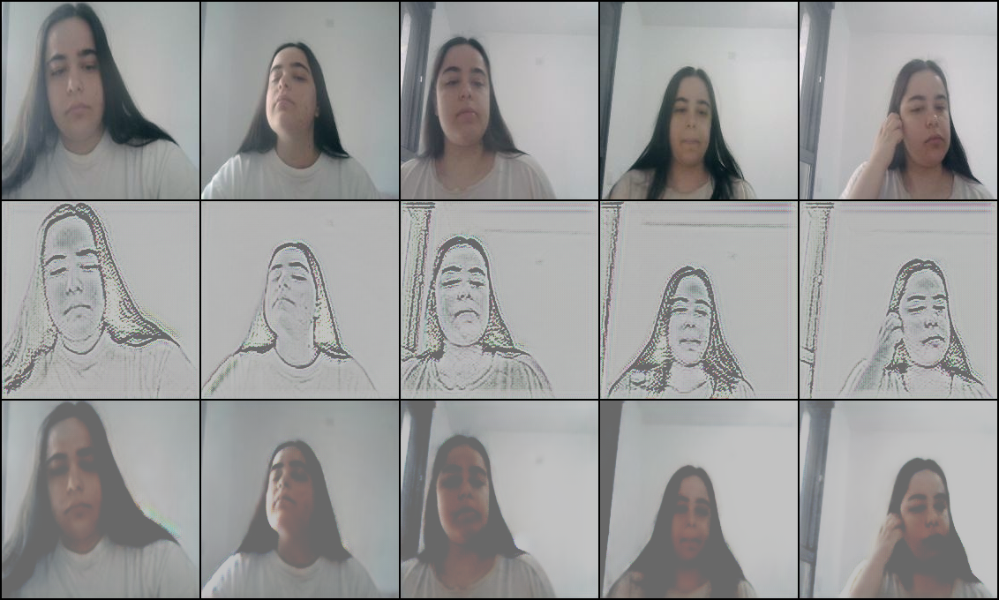

Saved progress images at epoch 50
Epoch [50/200] Loss_G: 1.5508, Loss_D_A: 0.0097, Loss_D_B: 0.0163, Loss_cycle_A: 2.5195, Loss_cycle_B: 2.5992
EarlyStopping counter: 1 out of 10
Epoch [51/200] Loss_G: 1.5518, Loss_D_A: 0.0096, Loss_D_B: 0.0162, Loss_cycle_A: 2.5202, Loss_cycle_B: 2.5978
EarlyStopping counter: 2 out of 10
Epoch [52/200] Loss_G: 1.5532, Loss_D_A: 0.0095, Loss_D_B: 0.0161, Loss_cycle_A: 2.5194, Loss_cycle_B: 2.5991
EarlyStopping counter: 3 out of 10
Epoch [53/200] Loss_G: 1.5540, Loss_D_A: 0.0095, Loss_D_B: 0.0160, Loss_cycle_A: 2.5185, Loss_cycle_B: 2.5960
Saved best generator models with cycle loss: 5.1145
Epoch [54/200] Loss_G: 1.5534, Loss_D_A: 0.0093, Loss_D_B: 0.0159, Loss_cycle_A: 2.5160, Loss_cycle_B: 2.5936
Saved best generator models with cycle loss: 5.1097


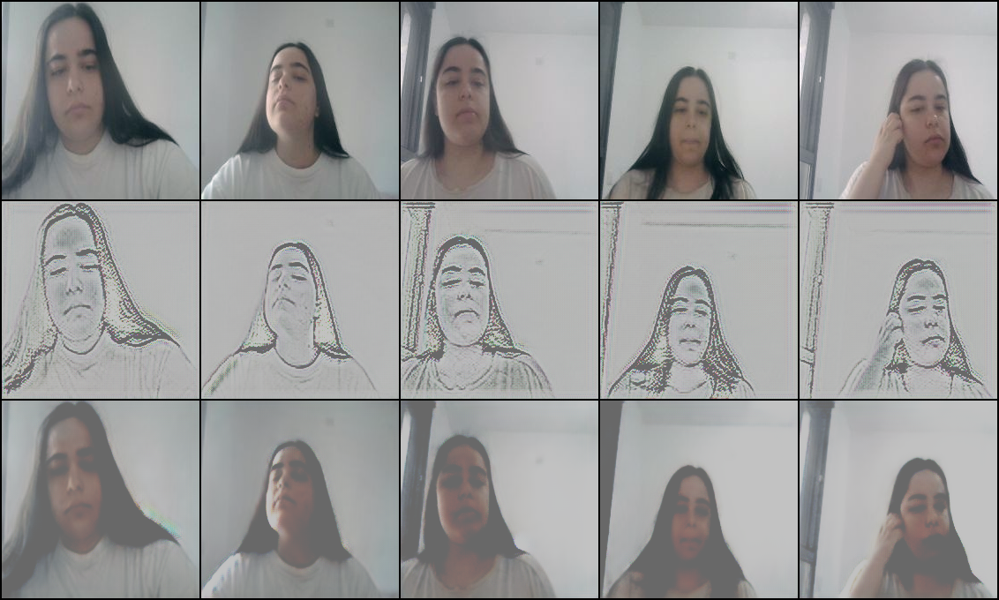

Saved progress images at epoch 55
Epoch [55/200] Loss_G: 1.5553, Loss_D_A: 0.0093, Loss_D_B: 0.0158, Loss_cycle_A: 2.5159, Loss_cycle_B: 2.5930
Saved best generator models with cycle loss: 5.1089
EarlyStopping counter: 1 out of 10
Epoch [56/200] Loss_G: 1.5553, Loss_D_A: 0.0093, Loss_D_B: 0.0158, Loss_cycle_A: 2.5146, Loss_cycle_B: 2.5951
EarlyStopping counter: 2 out of 10
Epoch [57/200] Loss_G: 1.5540, Loss_D_A: 0.0092, Loss_D_B: 0.0157, Loss_cycle_A: 2.5184, Loss_cycle_B: 2.5923
EarlyStopping counter: 3 out of 10
Epoch [58/200] Loss_G: 1.5565, Loss_D_A: 0.0092, Loss_D_B: 0.0156, Loss_cycle_A: 2.5159, Loss_cycle_B: 2.5912
Saved best generator models with cycle loss: 5.1071
Epoch [59/200] Loss_G: 1.5565, Loss_D_A: 0.0091, Loss_D_B: 0.0156, Loss_cycle_A: 2.5159, Loss_cycle_B: 2.5901
Saved best generator models with cycle loss: 5.1060


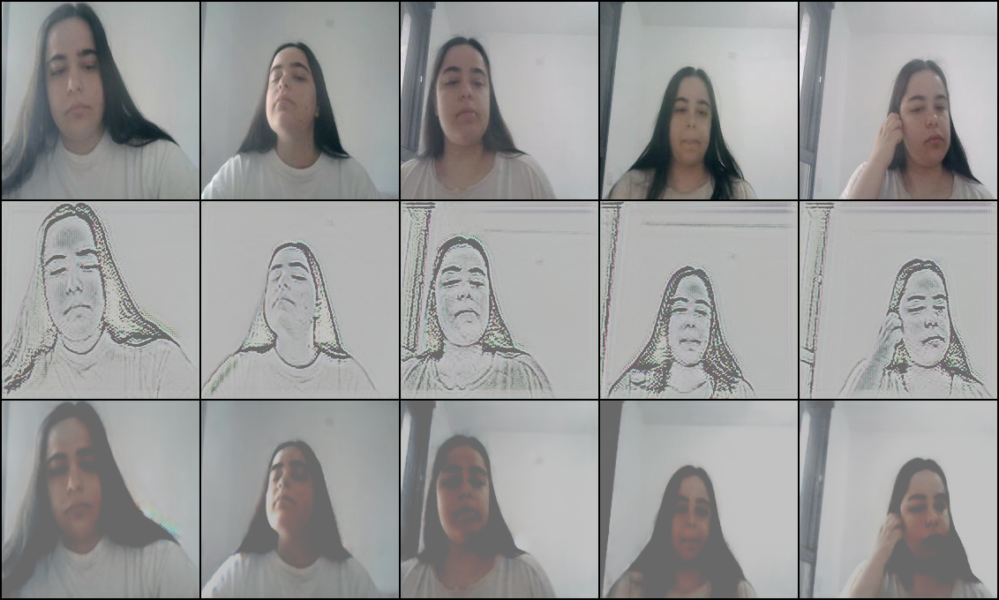

Saved progress images at epoch 60
Epoch [60/200] Loss_G: 1.5561, Loss_D_A: 0.0091, Loss_D_B: 0.0156, Loss_cycle_A: 2.5162, Loss_cycle_B: 2.5930
EarlyStopping counter: 1 out of 10
Epoch [61/200] Loss_G: 1.5566, Loss_D_A: 0.0091, Loss_D_B: 0.0155, Loss_cycle_A: 2.5150, Loss_cycle_B: 2.5922
EarlyStopping counter: 2 out of 10
Epoch [62/200] Loss_G: 1.5575, Loss_D_A: 0.0090, Loss_D_B: 0.0154, Loss_cycle_A: 2.5132, Loss_cycle_B: 2.5916
Saved best generator models with cycle loss: 5.1048
Epoch [63/200] Loss_G: 1.5564, Loss_D_A: 0.0090, Loss_D_B: 0.0154, Loss_cycle_A: 2.5145, Loss_cycle_B: 2.5929
EarlyStopping counter: 1 out of 10
Epoch [64/200] Loss_G: 1.5578, Loss_D_A: 0.0089, Loss_D_B: 0.0154, Loss_cycle_A: 2.5154, Loss_cycle_B: 2.5894
EarlyStopping counter: 2 out of 10


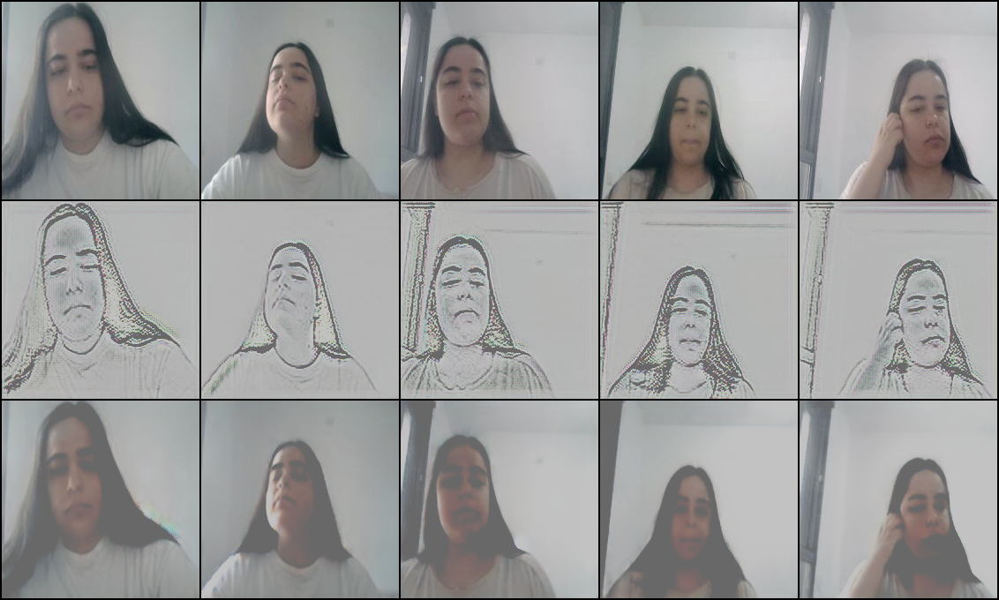

Saved progress images at epoch 65
Epoch [65/200] Loss_G: 1.5577, Loss_D_A: 0.0089, Loss_D_B: 0.0153, Loss_cycle_A: 2.5138, Loss_cycle_B: 2.5896
Saved best generator models with cycle loss: 5.1034
Epoch [66/200] Loss_G: 1.5579, Loss_D_A: 0.0089, Loss_D_B: 0.0153, Loss_cycle_A: 2.5131, Loss_cycle_B: 2.5892
Saved best generator models with cycle loss: 5.1022
Epoch [67/200] Loss_G: 1.5580, Loss_D_A: 0.0089, Loss_D_B: 0.0153, Loss_cycle_A: 2.5121, Loss_cycle_B: 2.5900
Saved best generator models with cycle loss: 5.1021
EarlyStopping counter: 1 out of 10
Epoch [68/200] Loss_G: 1.5579, Loss_D_A: 0.0088, Loss_D_B: 0.0153, Loss_cycle_A: 2.5118, Loss_cycle_B: 2.5886
Saved best generator models with cycle loss: 5.1004
Epoch [69/200] Loss_G: 1.5586, Loss_D_A: 0.0088, Loss_D_B: 0.0152, Loss_cycle_A: 2.5126, Loss_cycle_B: 2.5872
Saved best generator models with cycle loss: 5.0998
EarlyStopping counter: 1 out of 10


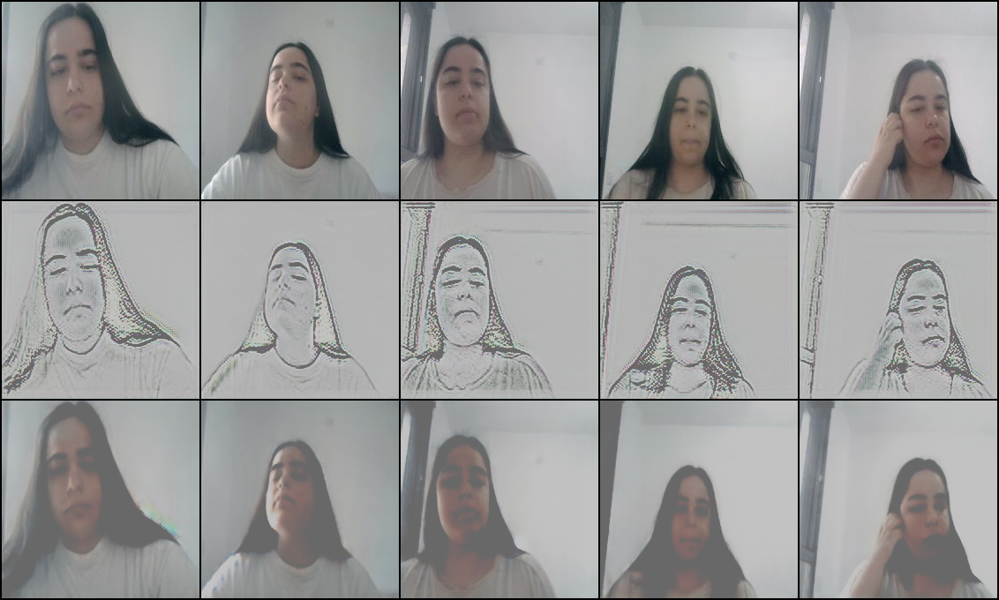

Saved progress images at epoch 70
Epoch [70/200] Loss_G: 1.5569, Loss_D_A: 0.0088, Loss_D_B: 0.0152, Loss_cycle_A: 2.5129, Loss_cycle_B: 2.5888
EarlyStopping counter: 2 out of 10
Epoch [71/200] Loss_G: 1.5600, Loss_D_A: 0.0088, Loss_D_B: 0.0152, Loss_cycle_A: 2.5146, Loss_cycle_B: 2.5870
EarlyStopping counter: 3 out of 10
Epoch [72/200] Loss_G: 1.5574, Loss_D_A: 0.0088, Loss_D_B: 0.0152, Loss_cycle_A: 2.5122, Loss_cycle_B: 2.5868
Saved best generator models with cycle loss: 5.0989
Epoch [73/200] Loss_G: 1.5587, Loss_D_A: 0.0088, Loss_D_B: 0.0151, Loss_cycle_A: 2.5114, Loss_cycle_B: 2.5882
EarlyStopping counter: 1 out of 10
Epoch [74/200] Loss_G: 1.5578, Loss_D_A: 0.0087, Loss_D_B: 0.0151, Loss_cycle_A: 2.5129, Loss_cycle_B: 2.5876
EarlyStopping counter: 2 out of 10


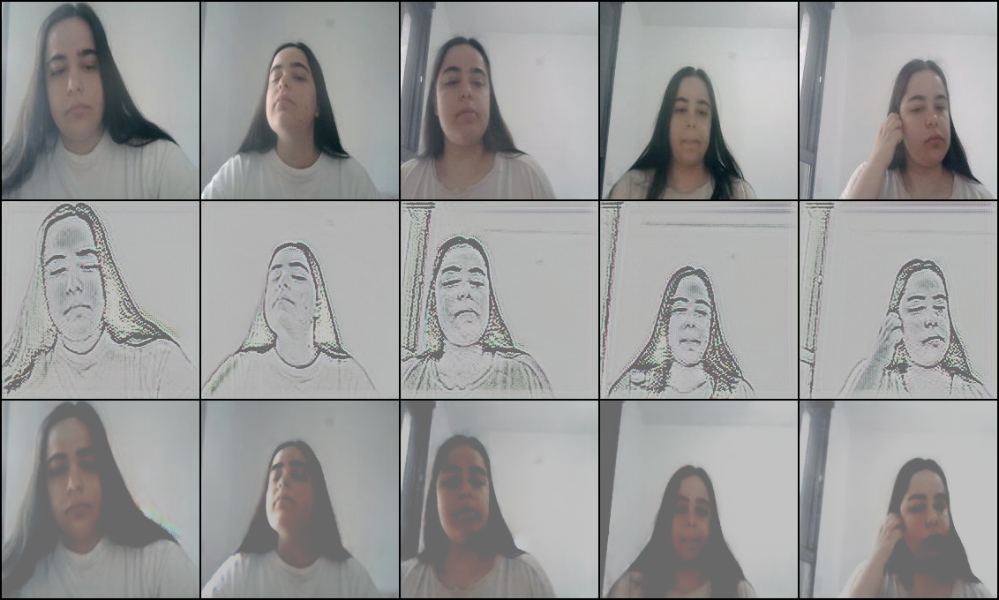

Saved progress images at epoch 75
Epoch [75/200] Loss_G: 1.5579, Loss_D_A: 0.0087, Loss_D_B: 0.0151, Loss_cycle_A: 2.5115, Loss_cycle_B: 2.5876
EarlyStopping counter: 3 out of 10
Epoch [76/200] Loss_G: 1.5599, Loss_D_A: 0.0087, Loss_D_B: 0.0151, Loss_cycle_A: 2.5109, Loss_cycle_B: 2.5860
Saved best generator models with cycle loss: 5.0969
Epoch [77/200] Loss_G: 1.5586, Loss_D_A: 0.0087, Loss_D_B: 0.0150, Loss_cycle_A: 2.5125, Loss_cycle_B: 2.5856
EarlyStopping counter: 1 out of 10
Epoch [78/200] Loss_G: 1.5585, Loss_D_A: 0.0087, Loss_D_B: 0.0150, Loss_cycle_A: 2.5101, Loss_cycle_B: 2.5881
EarlyStopping counter: 2 out of 10
Epoch [79/200] Loss_G: 1.5589, Loss_D_A: 0.0087, Loss_D_B: 0.0150, Loss_cycle_A: 2.5105, Loss_cycle_B: 2.5867
EarlyStopping counter: 3 out of 10


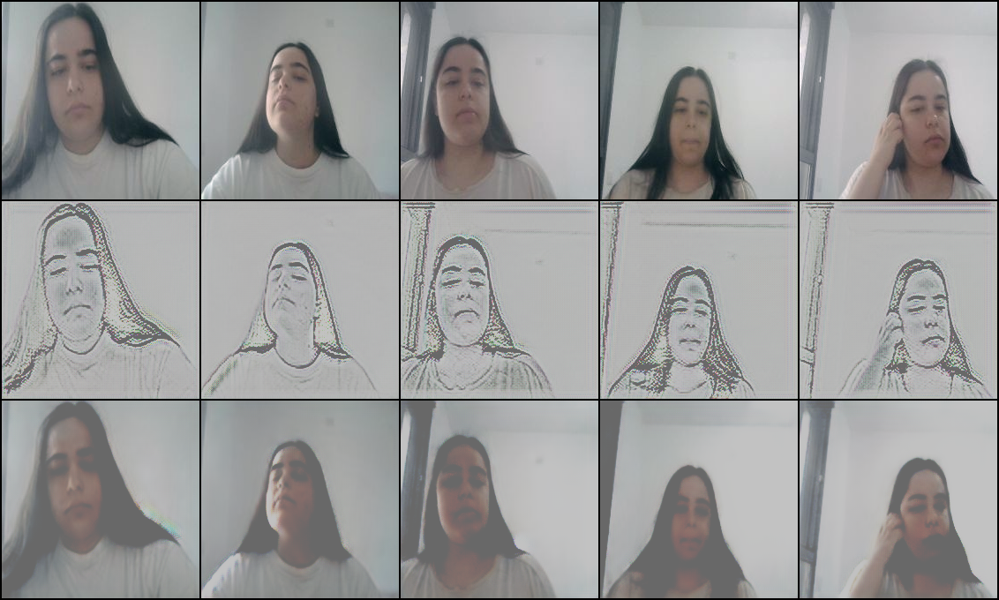

Saved progress images at epoch 80
Epoch [80/200] Loss_G: 1.5589, Loss_D_A: 0.0087, Loss_D_B: 0.0150, Loss_cycle_A: 2.5115, Loss_cycle_B: 2.5862
EarlyStopping counter: 4 out of 10
Epoch [81/200] Loss_G: 1.5592, Loss_D_A: 0.0086, Loss_D_B: 0.0150, Loss_cycle_A: 2.5112, Loss_cycle_B: 2.5882
EarlyStopping counter: 5 out of 10
Epoch [82/200] Loss_G: 1.5589, Loss_D_A: 0.0086, Loss_D_B: 0.0149, Loss_cycle_A: 2.5118, Loss_cycle_B: 2.5875
EarlyStopping counter: 6 out of 10
Epoch [83/200] Loss_G: 1.5601, Loss_D_A: 0.0086, Loss_D_B: 0.0149, Loss_cycle_A: 2.5102, Loss_cycle_B: 2.5852
Saved best generator models with cycle loss: 5.0954
Epoch [84/200] Loss_G: 1.5587, Loss_D_A: 0.0086, Loss_D_B: 0.0149, Loss_cycle_A: 2.5118, Loss_cycle_B: 2.5866
EarlyStopping counter: 1 out of 10


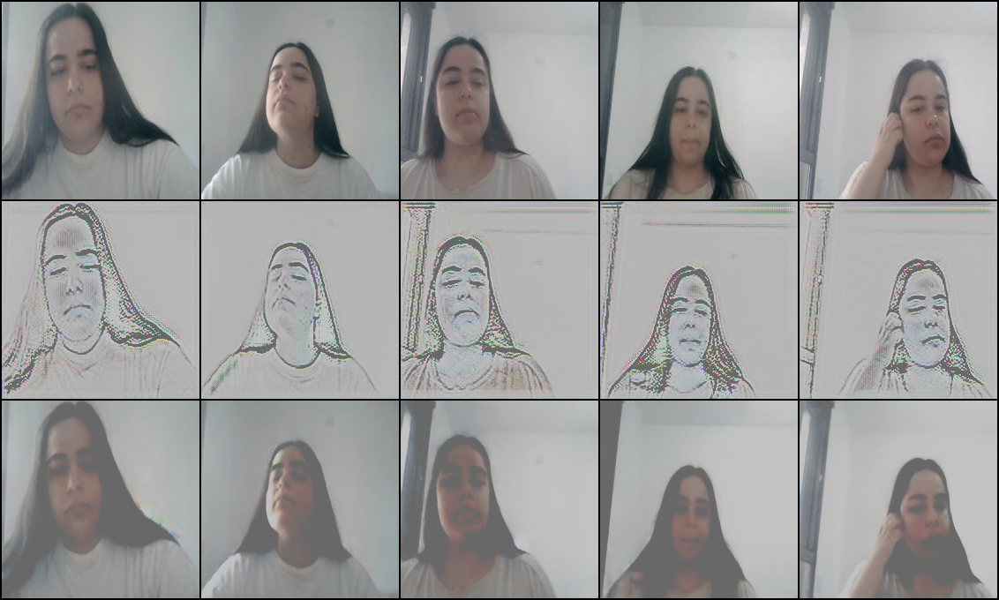

Saved progress images at epoch 85
Epoch [85/200] Loss_G: 1.5593, Loss_D_A: 0.0086, Loss_D_B: 0.0149, Loss_cycle_A: 2.5119, Loss_cycle_B: 2.5852
EarlyStopping counter: 2 out of 10
Epoch [86/200] Loss_G: 1.5593, Loss_D_A: 0.0086, Loss_D_B: 0.0149, Loss_cycle_A: 2.5096, Loss_cycle_B: 2.5863
EarlyStopping counter: 3 out of 10
Epoch [87/200] Loss_G: 1.5594, Loss_D_A: 0.0086, Loss_D_B: 0.0149, Loss_cycle_A: 2.5105, Loss_cycle_B: 2.5836
Saved best generator models with cycle loss: 5.0941
Epoch [88/200] Loss_G: 1.5580, Loss_D_A: 0.0086, Loss_D_B: 0.0149, Loss_cycle_A: 2.5112, Loss_cycle_B: 2.5831
EarlyStopping counter: 1 out of 10
Epoch [89/200] Loss_G: 1.5594, Loss_D_A: 0.0086, Loss_D_B: 0.0148, Loss_cycle_A: 2.5092, Loss_cycle_B: 2.5849
EarlyStopping counter: 2 out of 10


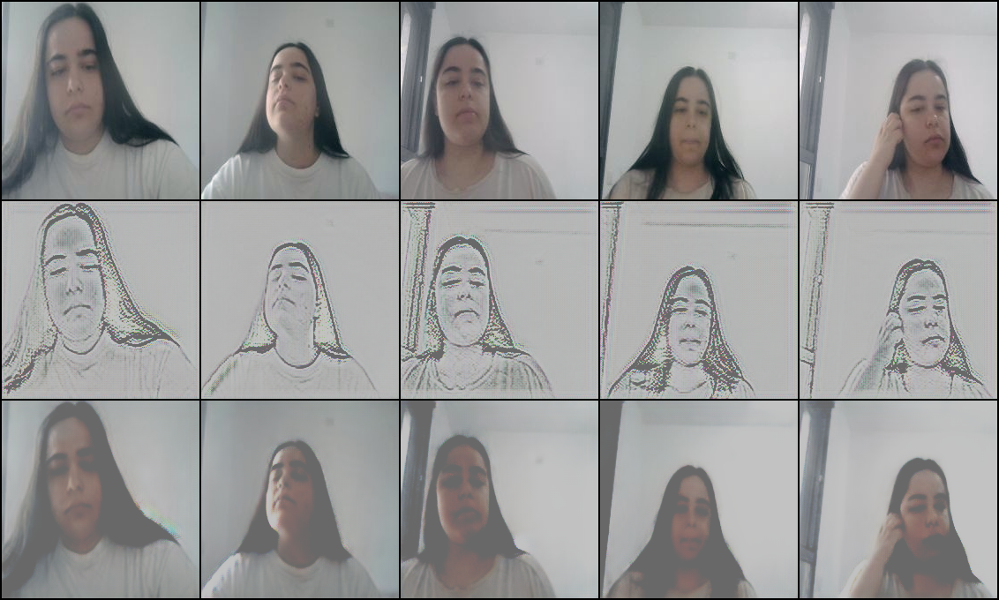

Saved progress images at epoch 90
Epoch [90/200] Loss_G: 1.5604, Loss_D_A: 0.0086, Loss_D_B: 0.0148, Loss_cycle_A: 2.5097, Loss_cycle_B: 2.5854
EarlyStopping counter: 3 out of 10
Epoch [91/200] Loss_G: 1.5597, Loss_D_A: 0.0086, Loss_D_B: 0.0148, Loss_cycle_A: 2.5087, Loss_cycle_B: 2.5865
EarlyStopping counter: 4 out of 10
Epoch [92/200] Loss_G: 1.5612, Loss_D_A: 0.0086, Loss_D_B: 0.0148, Loss_cycle_A: 2.5095, Loss_cycle_B: 2.5855
EarlyStopping counter: 5 out of 10
Epoch [93/200] Loss_G: 1.5593, Loss_D_A: 0.0086, Loss_D_B: 0.0148, Loss_cycle_A: 2.5094, Loss_cycle_B: 2.5849
EarlyStopping counter: 6 out of 10
Epoch [94/200] Loss_G: 1.5570, Loss_D_A: 0.0085, Loss_D_B: 0.0148, Loss_cycle_A: 2.5103, Loss_cycle_B: 2.5854
EarlyStopping counter: 7 out of 10


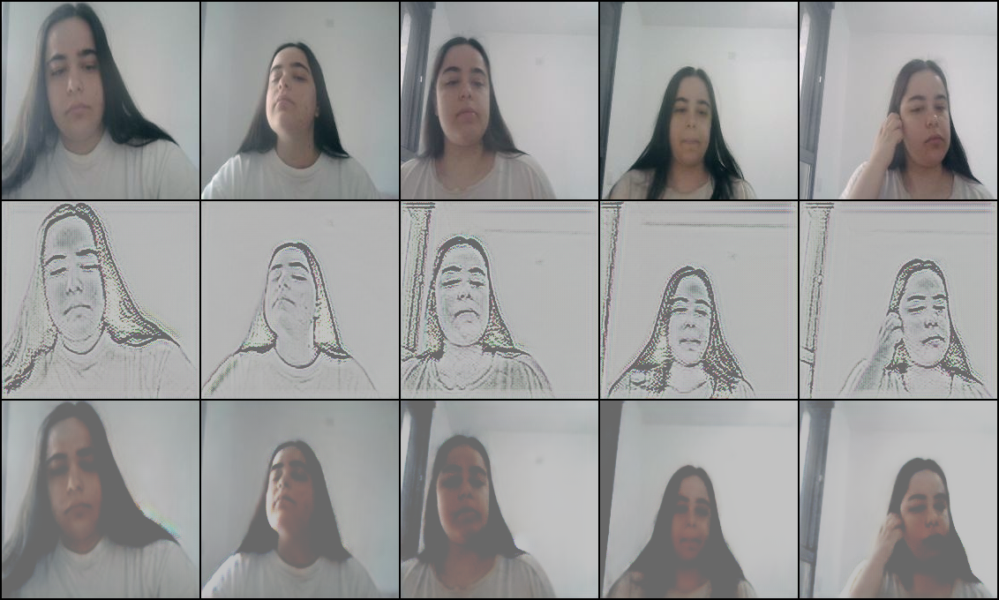

Saved progress images at epoch 95
Epoch [95/200] Loss_G: 1.5594, Loss_D_A: 0.0086, Loss_D_B: 0.0148, Loss_cycle_A: 2.5106, Loss_cycle_B: 2.5852
EarlyStopping counter: 8 out of 10
Epoch [96/200] Loss_G: 1.5585, Loss_D_A: 0.0085, Loss_D_B: 0.0148, Loss_cycle_A: 2.5091, Loss_cycle_B: 2.5858
EarlyStopping counter: 9 out of 10
Epoch [97/200] Loss_G: 1.5591, Loss_D_A: 0.0085, Loss_D_B: 0.0148, Loss_cycle_A: 2.5105, Loss_cycle_B: 2.5845
EarlyStopping counter: 10 out of 10
Early stopping triggered
Finished Training


In [ ]:
#ניסיון שני- מדדים טובים בראשון + 200 אפוקים לאימון ממוקד יותר
# lambda_cycle = 10
from IPython.display import Image, display
# Create EarlyStopping object with defined patience and delta
early_stopping = EarlyStopping(patience=10, delta=0.001)

# Variables for saving fixed input images for visual comparison
fixed_real_A = None
fixed_real_B = None
num_fixed_images = 5
checkpoint_interval_images = 5
progress_image_dir = 'training_progress_images'
os.makedirs(progress_image_dir, exist_ok=True)

# Initialize tracking variables
best_cycle_loss = float('inf')
losses_G = []
losses_D_A = []
losses_D_B = []
losses_cycle_A = []
losses_cycle_B = []

# --- Training Loop ---
for epoch in range(num_epochs):
    # Initialize per-epoch loss
    epoch_losses = {
        'G_AtoB': 0,
        'G_BtoA': 0,
        'D_A': 0,
        'D_B': 0,
        'cycle_A': 0,
        'cycle_B': 0
    }

    # Iterate through both dataloaders simultaneously
    for i, (data_A, data_B) in enumerate(zip(dataloader_A, dataloader_B)):
        real_A, _ = data_A
        real_B, _ = data_B

        # Set input data and perform optimization step
        model.set_input(real_A, real_B)
        model.optimize_parameters()

        # Accumulate losses
        losses = model.get_current_losses()
        for k, v in losses.items():
            epoch_losses[k] += v

        # Save fixed inputs once in the first iteration of first epoch
        if epoch == 0 and i == 0:
            fixed_real_A = real_A[:num_fixed_images].to(device)
            fixed_real_B = real_B[:num_fixed_images].to(device)

    # Compute average losses for the epoch
    for k in epoch_losses:
        epoch_losses[k] /= len(dataloader_A)

    # Track losses
    losses_G.append(epoch_losses['G_AtoB'] + epoch_losses['G_BtoA'])
    losses_D_A.append(epoch_losses['D_A'])
    losses_D_B.append(epoch_losses['D_B'])
    losses_cycle_A.append(epoch_losses['cycle_A'])
    losses_cycle_B.append(epoch_losses['cycle_B'])
    avg_gen_loss = losses_G[-1]

    # --- Visualization of fixed images ---
    if (epoch == 0 or (fixed_real_A is not None and fixed_real_B is not None and (epoch + 1) % checkpoint_interval_images == 0)):
        with torch.no_grad():
            # Generate fake and reconstructed images
            fake_B_fixed = model.G_AtoB(fixed_real_A)
            reconstructed_A_fixed = model.G_BtoA(fake_B_fixed)
            fake_A_fixed = model.G_BtoA(fixed_real_B)
            reconstructed_B_fixed = model.G_AtoB(fake_A_fixed)

            # Concatenate images for side-by-side comparison
            comparison_AtoB = torch.cat([fixed_real_A.cpu(), fake_B_fixed.cpu(), reconstructed_A_fixed.cpu()], dim=0)
            comparison_BtoA = torch.cat([fixed_real_B.cpu(), fake_A_fixed.cpu(), reconstructed_B_fixed.cpu()], dim=0)

            # Save visual progress images
            vutils.save_image(comparison_AtoB,
                              f'{progress_image_dir}/epoch_{epoch+1}_AtoB.png',
                              normalize=True, nrow=num_fixed_images)
            vutils.save_image(comparison_BtoA,
                              f'{progress_image_dir}/epoch_{epoch+1}_BtoA.png',
                              normalize=True, nrow=num_fixed_images)
            image_filename_AtoB = f'{progress_image_dir}/epoch_{epoch+1}_AtoB.png'
            display(Image(filename=image_filename_AtoB))
            print(f"Saved progress images at epoch {epoch+1}")

    # --- Logging and Checkpointing ---
    print(f"Epoch [{epoch+1}/{num_epochs}] "
          f"Loss_G: {avg_gen_loss:.4f}, Loss_D_A: {epoch_losses['D_A']:.4f}, Loss_D_B: {epoch_losses['D_B']:.4f}, "
          f"Loss_cycle_A: {epoch_losses['cycle_A']:.4f}, Loss_cycle_B: {epoch_losses['cycle_B']:.4f}")

    cycle_loss = epoch_losses['cycle_A'] + epoch_losses['cycle_B']

    # Save the best generator models based on cycle consistency loss
    if cycle_loss < best_cycle_loss:
        best_cycle_loss = cycle_loss
        torch.save(model.G_AtoB.state_dict(), 'best_generator_AtoB_model.pth')
        torch.save(model.G_BtoA.state_dict(), 'best_generator_BtoA_model.pth')
        print(f"Saved best generator models with cycle loss: {best_cycle_loss:.4f}")
        early_stopping.reset_counter()

    # Early stopping check
    early_stopping(cycle_loss)
    if early_stopping.early_stop:
        print("Early stopping triggered")
        break

    # Update learning rate schedulers
    model.scheduler_G.step()
    model.scheduler_D_A.step()
    model.scheduler_D_B.step()

print("Finished Training")

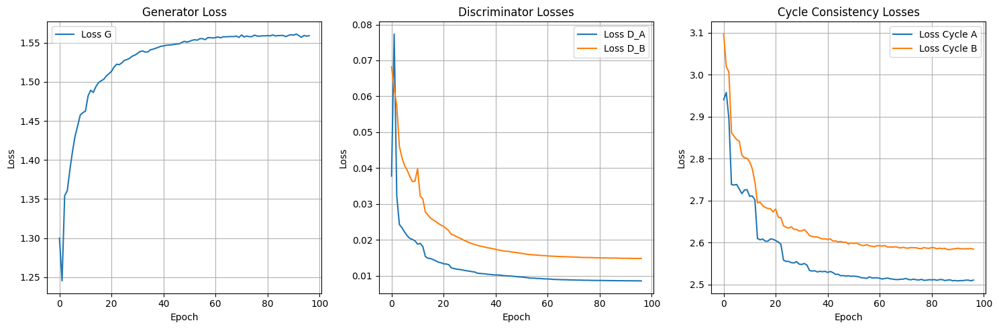

In [ ]:
# # 200 אפוקים + למדה 10


plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(losses_G, label='Loss G')
plt.title('Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 2)
plt.plot(losses_D_A, label='Loss D_A')
plt.plot(losses_D_B, label='Loss D_B')
plt.title('Discriminator Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 3)
plt.plot(losses_cycle_A, label='Loss Cycle A')
plt.plot(losses_cycle_B, label='Loss Cycle B')
plt.title('Cycle Consistency Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
def create_gif_from_images(image_dir, output_gif_path, fps=5):
    image_files_with_epoch_num = []
    for filename in os.listdir(image_dir):
        if filename.startswith('epoch_') and filename.endswith('_AtoB.png'):
            match = re.search(r'epoch_(\d+)_AtoB\.png', filename)
            if match:
                epoch_num = int(match.group(1))
                image_files_with_epoch_num.append((epoch_num, os.path.join(image_dir, filename)))

    image_files_with_epoch_num.sort(key=lambda x: x[0])
    image_files = [path for epoch_num, path in image_files_with_epoch_num]

    if not image_files:
        print(f"No images found in directory {image_dir} matching the pattern.")
        return

    print(f"Found {len(image_files)} images for GIF creation.")

    images = []

    for filename in image_files:
        images.append(imageio.imread(filename))

    imageio.mimsave(output_gif_path, images, fps=fps)
    print(f"Gif created: {output_gif_path}")

image_directory = '/content/dataset/training_progress_images- One image'
output_gif = 'training_AtoB_progress.gif'
frames_per_second = 3

create_gif_from_images(image_directory, output_gif, frames_per_second)

Found 21 images for GIF creation.
Gif created: training_AtoB_progress.gif


In [ ]:
# download model
files.download('best_generator_AtoB_model.pth')
files.download('best_generator_BtoA_model.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Inference

Successfully loaded the best saved models.


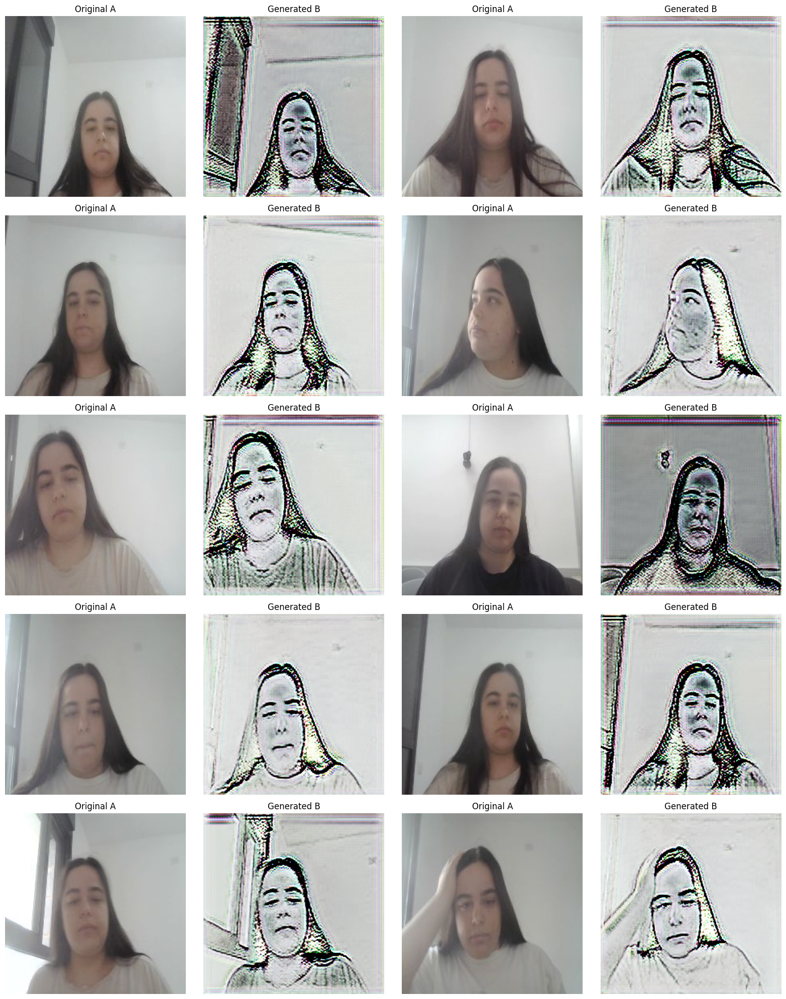

In [ ]:
# Load the model (ensure the CycleGANModel class is defined as during training)
ngf = 64  # Number of generator filters in the first conv layer (must match training configuration)
model = CycleGANModel(ngf=ngf).to(device)

# Load the saved best weights
try:
    model_option = 'option2'
    model.G_AtoB.load_state_dict(torch.load(f'/content/dataset/best_generator_AtoB_model_{model_option}.pth', map_location=device))
    model.G_BtoA.load_state_dict(torch.load(f'/content/dataset/best_generator_BtoA_model_{model_option}.pth', map_location=device))
    print("Successfully loaded the best saved models.")
except FileNotFoundError:
    print("Error: Saved model files not found. Ensure they exist in the current directory.")
    exit()

# Set the model to evaluation mode
model.eval()

def show_generated_reconstructed_A(real_A, fake_B):
    to_pil = transforms.ToPILImage()
    num_images = real_A.size(0)

    # Now we display 2 images per original input (Original A, Generated B)
    total_images_to_display = num_images * 2
    ncols = 4
    nrows = (total_images_to_display + ncols - 1) // ncols

    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 4))
    axes = axes.flatten()

    for i in range(num_images):
        # --- Display Original A ---
        # Get the original image tensor
        original_A_display = real_A[i].cpu().detach()

        # Perform inverse normalization for Original A
        # Using the mean_A_test and std_A_test that were used for the original normalization
        # Formula: X = (X_norm * std) + mean
        # Ensure mean_A_test and std_A_test are defined and accessible here.
        # This loop iterates through the 3 color channels (RGB)
        for c in range(3):
            original_A_display[c] = (original_A_display[c] * std_A_test[c]) + mean_A_test[c]

        # Clamp values to [0, 1] to handle potential floating point inaccuracies
        original_A_display = torch.clamp(original_A_display, 0, 1)

        axes[i * 2].set_title("Original A") # New title for original image
        axes[i * 2].imshow(to_pil(original_A_display)) # Display the inversely normalized image
        axes[i * 2].axis('off')

        # --- Display Generated B ---
        # This image is typically normalized to [-1, 1] by the generator's Tanh output,
        # so we use the (x+1)/2 normalization.
        axes[i * 2 + 1].set_title("Generated B")
        axes[i * 2 + 1].imshow(to_pil((fake_B[i].cpu().detach() + 1) / 2))
        axes[i * 2 + 1].axis('off')

    # Turn off any remaining empty subplots
    for j in range(num_images * 2, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.savefig("generated_and_original_A.png") # Changed filename to reflect content
    plt.show()

# Get one batch of data from domain A
try:
    data_A = next(iter(dataloader_test_A))
    real_A, _ = data_A
    real_A = real_A[:10].to(device) # Using 10 images for demonstration (changed from 4 for clarity)

    # (torch.no_grad() disables gradient computation to save memory and speed up inference)
    with torch.no_grad():
        # Generate fake images in domain B from real images in domain A
        fake_B = model.G_AtoB(real_A)

    # Call the display function with the updated arguments
    show_generated_reconstructed_A(real_A.cpu(), fake_B.cpu())

except NameError:
    print("Error: DataLoader (dataloader_test_A), mean_A_test, or std_A_test are not defined. Ensure they were created and are accessible before running this code.")
except StopIteration:
    print("Error: DataLoader A is empty. Check your dataset path and content.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

In [ ]:
# imports
from IPython.display import Image
from google.colab.patches import cv2_imshow
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import PIL
import io
import html
import time
import matplotlib.pyplot as plt
import datetime
%matplotlib inline

# Set the model to evaluation mode
model.eval()
with_inference = True
frameNum = 0

video_stream()
label_html = 'Capturing...'
bbox = ''
count = 0

while True:
    frameNum += 1
    # Capture a frame from the webcam and get the response
    js_reply = video_frame(label_html, bbox, width, height)
    if not js_reply:
        break

     # Convert the received JavaScript image to a numpy array
    frame = js_to_image(js_reply["img"])
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Preprocess the frame: Resize, convert to float tensor and Normalize to [-1, 1] range (CycleGAN expects this format)
    input_frame = cv2.resize(frame_rgb, (image_size, image_size))
    input_tensor = torch.from_numpy(input_frame).float().permute(2, 0, 1).unsqueeze(0) / 255.0
    input_tensor = (input_tensor - 0.5) * 2
    input_tensor = input_tensor.to(device)

    if with_inference:
        a = datetime.datetime.now()
        with torch.no_grad():
            fake_B = model.G_AtoB(input_tensor) # Generate image in domain B

        b = datetime.datetime.now()
        label_html = f'Capturing... {(b-a).total_seconds() * 1000:.2f}ms'

         # Post-process the output: Convert from [-1, 1] to [0, 1], Convert to HWC format, scale to [0, 255] and convert to uint8
        output_image = fake_B.squeeze().detach().cpu()
        output_image = (output_image + 1) / 2
        output_image = output_image.permute(1, 2, 0).numpy()
        output_image = (output_image * 255).clip(0, 255).astype(np.uint8)

        # Convert to RGBA format for display in the browser
        output_rgba = cv2.cvtColor(output_image, cv2.COLOR_RGB2RGBA)

        #  Convert the image to base64 string for rendering in the video stream
        bbox_bytes = bbox_to_bytes(output_rgba)
        bbox = bbox_bytes

    else:
        label_html = 'Capturing...' + str(frameNum)


<IPython.core.display.Javascript object>